In [2]:
import pandas as pd
x = pd.read_csv('vol/intermediate_result/x.csv').drop('gross',axis=1).drop('worldwide_gross',axis=1)

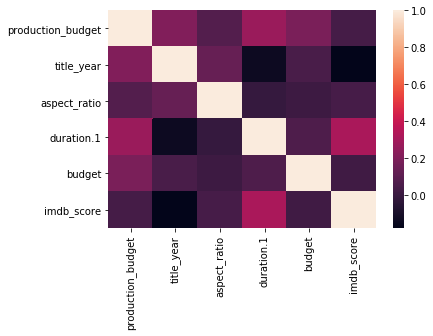

In [3]:
import seaborn as sns
%matplotlib inline

sns.heatmap(x.corr())

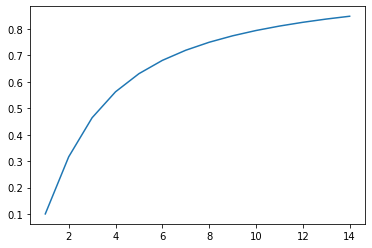

In [4]:
import matplotlib.pyplot as plt
import numpy as np

x = np.arange(1,15)
y = np.power(0.1,1/x)
plt.plot(x,y)


In [5]:
x = pd.read_csv('vol/intermediate_result/x.csv')

y = x['worldwide_gross']
x = x.drop('worldwide_gross',axis=1)

In [6]:
from sklearn.linear_model import Lasso

model = Lasso()

In [7]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(x,y)


In [8]:
len(x_train)/len(x)

0.75

In [9]:
model.fit(x_train,y_train)

Lasso(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=1000,
      normalize=False, positive=False, precompute=False, random_state=None,
      selection='cyclic', tol=0.0001, warm_start=False)

In [10]:
model.score(x_test,y_test)

0.8287632859205873

In [11]:
model.coef_

array([ 1.10760636e+00,  8.24864226e+05, -4.60238037e+06,  3.64777885e+04,
       -3.04448621e-04,  8.04643369e+06,  1.93669974e+00])

In [12]:
var = np.floor(np.log10(np.abs(model.coef_)))

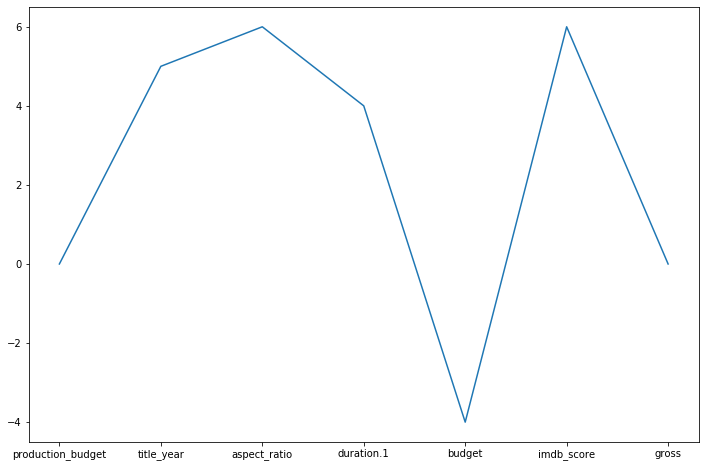

In [13]:
plt.rcParams['figure.figsize'] = [12,8]
plt.plot(var)
plt.xticks(np.arange(7),list(x.columns));

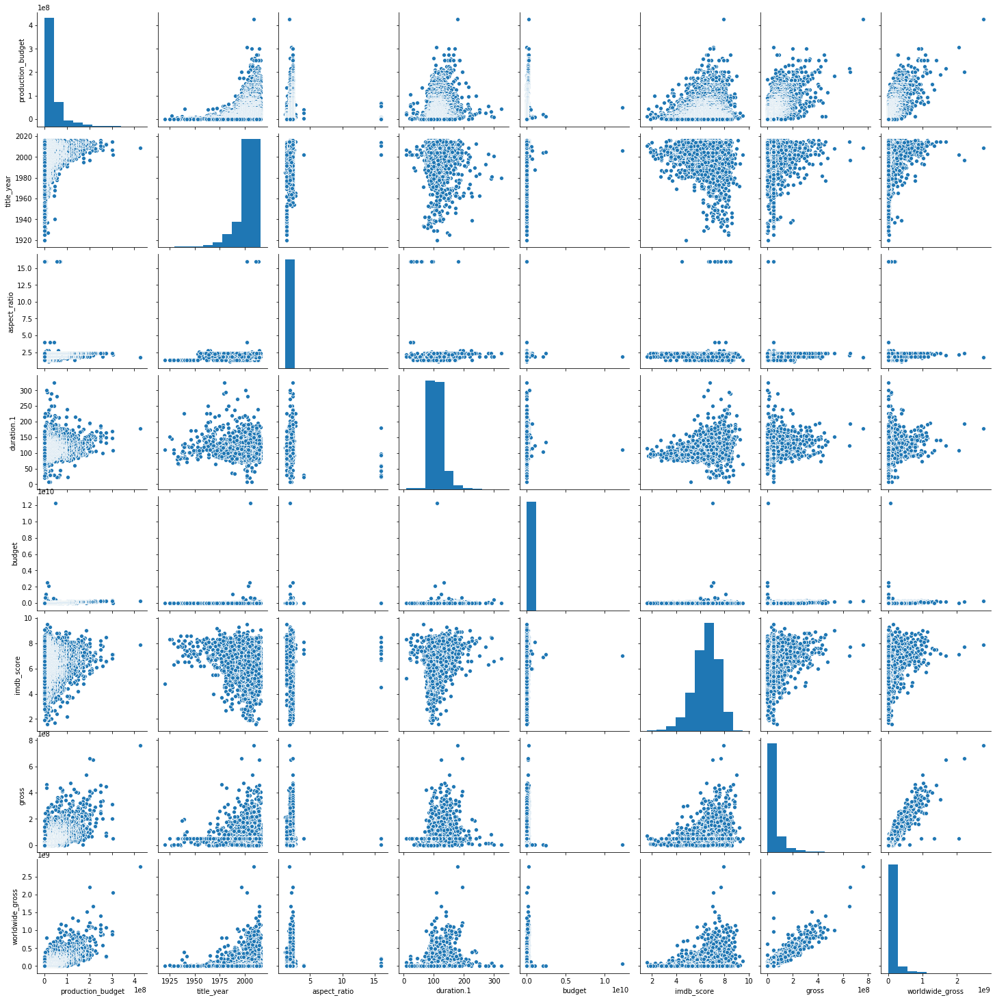

In [14]:
import seaborn as sns
z = pd.concat([x,y],axis=1)
sns.pairplot(z)

In [27]:
clase = pd.cut(x['production_budget'],8).cat.codes.rename('class')
z2 = pd.concat([x,clase],axis=1).head(2)

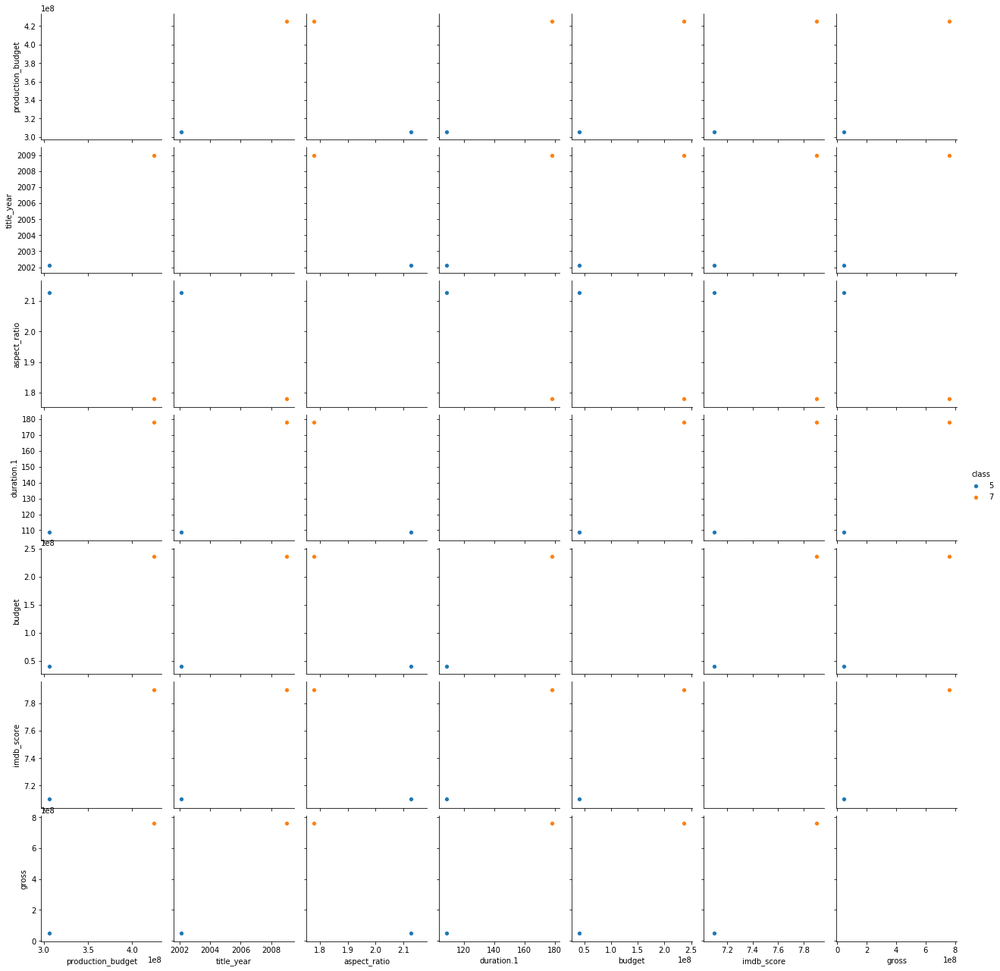

In [28]:
sns.pairplot(z2,hue='class')

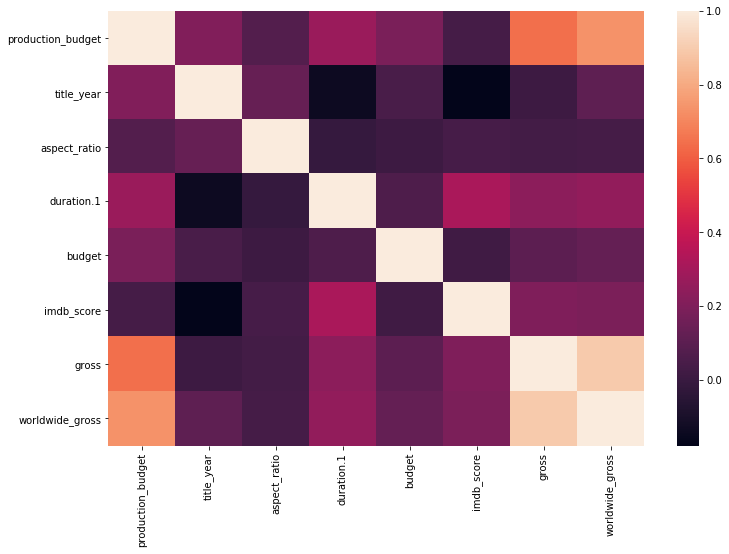

In [29]:
z3 = pd.concat([x,y],axis=1)
sns.heatmap(z3.corr())

In [30]:
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import mutual_info_regression

selector = SelectKBest(mutual_info_regression,k=4)
selector.fit(x,y)

SelectKBest(k=4,
            score_func=<function mutual_info_regression at 0x0000026B7676E558>)

([<matplotlib.axis.XTick at 0x26b771c93c8>,
 <a list of 7 Text xticklabel objects>)

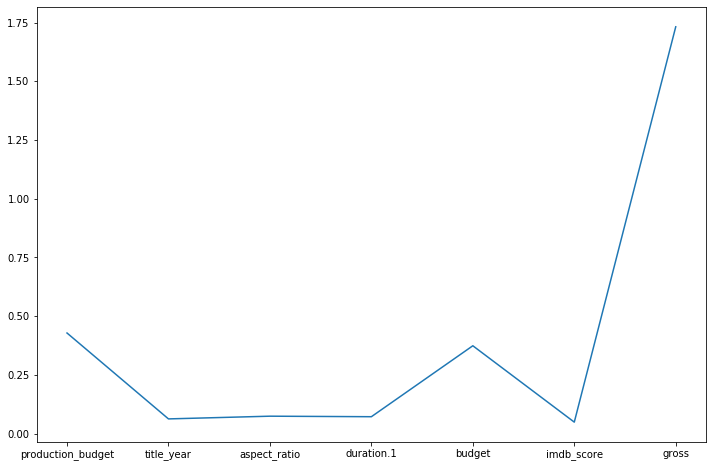

In [32]:
scores = selector.scores_
plt.rcParams['figure.figsize'] = [12,8]
plt.plot(scores)
plt.xticks(np.arange(7),list(x.columns))